In [116]:
!pip install shap
!pip install lime
!pip install transformers

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [117]:
import shap
import pickle
import numpy as np
import pandas as pd
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer

# LIME packages
from lime import lime_text
from lime.lime_text import LimeTextExplainer
from sklearn.pipeline import make_pipeline
from lime.lime_text import IndexedString,IndexedCharacters
from lime.lime_base import LimeBase
from sklearn.linear_model import Ridge, lars_path
from lime.lime_text import explanation
from functools import partial
import scipy as sp
from sklearn.utils import check_random_state
from sklearn.metrics import classification_report


from transformers import AutoTokenizer, TFAutoModel
import tensorflow as tf
from tqdm import tqdm

In [118]:
!pip install gdown

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [119]:
'''
https://drive.google.com/file/d/1-D-vwSDK6qPH2TN8owr1Uy3JQSKitpVH/view?usp=drive_link
https://drive.google.com/file/d/1-8HVDyZkJwLxn4Dc-SqNWlZZkd3jFvF_/view?usp=drive_link
https://drive.google.com/file/d/1-7saiHjQojSkvxbrkz1d4ebryH252Iox/view?usp=drive_link
'''

'\nhttps://drive.google.com/file/d/1-D-vwSDK6qPH2TN8owr1Uy3JQSKitpVH/view?usp=drive_link\nhttps://drive.google.com/file/d/1-8HVDyZkJwLxn4Dc-SqNWlZZkd3jFvF_/view?usp=drive_link\nhttps://drive.google.com/file/d/1-7saiHjQojSkvxbrkz1d4ebryH252Iox/view?usp=drive_link\n'

In [120]:
!gdown 1-D-vwSDK6qPH2TN8owr1Uy3JQSKitpVH
!gdown 1-8HVDyZkJwLxn4Dc-SqNWlZZkd3jFvF_
!gdown 1-7saiHjQojSkvxbrkz1d4ebryH252Iox

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Downloading...
From: https://drive.google.com/uc?id=1-D-vwSDK6qPH2TN8owr1Uy3JQSKitpVH
To: /kaggle/working/test.pkl
100%|█████████████████████████████████████████| 638k/638k [00:00<00:00, 113MB/s]
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Downloading...
From: https://drive.google.com/uc?id=1-8HVDyZkJwLxn4Dc-SqNWlZZkd3jFvF_
To: /kaggle/working/train.pkl
100%|███████████████████████████████████

In [121]:
FILE_PATH = "/kaggle/working/train.pkl"

with open(FILE_PATH, 'rb') as f:
    df_train = pickle.load(f)

In [122]:
FILE_PATH = "/kaggle/working/test.pkl"

with open(FILE_PATH, 'rb') as f:
    df_test = pickle.load(f)

In [123]:
FILE_PATH = "/kaggle/working/val.pkl"

with open(FILE_PATH, 'rb') as f:
    df_val = pickle.load(f)

In [124]:
df_train.reset_index(drop = True, inplace = True)
df_test.reset_index(drop = True, inplace = True)
df_val.reset_index(drop = True, inplace = True)

In [125]:
df_train.head()

,tweet,label,tweet_with_replaced_emojis,cleaned_data_with_replaced_emojis,Light Stemming
0,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,1,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,يامهند ياحبيبي تدور لبش اي احد متاكد ابو جاسم ...,يامهند ياحبيبي تدور لبش اي احد متاكد ابو جاسم ...
1,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,3,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفرين اعتقال عشرات الشباب قريه باسوطه ريف ...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...
2,انا نفسي مره اجرب اكون ليك حد اقرب : ),3,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,مره اجرب اكون ليك اقرب
3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...
4,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,0,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...


In [126]:
print(df_train.shape)
print(df_test.shape)
print(df_val.shape)

(7045, 5)
(1510, 5)
(1510, 5)


In [127]:
marbert_model_path = 'UBC-NLP/MARBERT'
tokenizer = AutoTokenizer.from_pretrained(marbert_model_path, from_tf=True)
marbert_model = TFAutoModel.from_pretrained(marbert_model_path, output_hidden_states=True)

All model checkpoint layers were used when initializing TFBertModel.

All the layers of TFBertModel were initialized from the model checkpoint at UBC-NLP/MARBERT.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [128]:
remove_special_tokens=0  #change this to 0 if you want to keep the special token
stemtype = 'cleaned_data_with_replaced_emojis'

In [129]:
def bert_tokenize(text: str) -> dict:
  tokens = tokenizer(text, padding='max_length', truncation=True, max_length=50)
  if remove_special_tokens == 1:
    shape = np.array(tokens['input_ids']).shape
    modified_input_ids = np.zeros(shape).astype(np.int32)
    modified_attention_mask = np.zeros(shape).astype(np.int32)
    # Modify the input IDs and attention mask as per your requirement
    for i in range(shape[0]):
      modified_input_ids[i] = [0 if token_id == 1 else 0 if token_id == 3 else 0 if token_id == 0 else 0 if token_id == 2 else 0 if token_id == 4 else token_id for token_id in tokens['input_ids'][i]]
      modified_attention_mask[i] = [0 if token_id in [1, 3, 0, 2, 4] else 1 for token_id in tokens['input_ids'][i]]
    # Update the input IDs and attention mask in the tokens dictionary
    tokens['input_ids'] = modified_input_ids
    tokens['attention_mask'] = modified_attention_mask
  return tokens

In [130]:
def get_embeddings(ids, mask, type_ids):
  ids = tf.convert_to_tensor(ids)
  #print(ids.shape)
  mask = tf.convert_to_tensor(mask)
  #print(mask.shape)
  #print(mask)
  type_ids = tf.convert_to_tensor(type_ids)
  #print(type_ids.shape)
  hidden_states = marbert_model(input_ids=ids, attention_mask=mask, token_type_ids=type_ids)[0]
  averaged_embedding = tf.reduce_mean(hidden_states, axis=1)
  return averaged_embedding.numpy()

In [131]:
label_to_class = [
    'none',
    'anger',
    'joy',
    'sadness',
    'love',
    'sympathy',
    'surprise',
    'fear'
]

In [132]:
label_to_class_dic = {
    0:'none',
    1:'anger',
    2:'joy',
    3:'sadness',
    4:'love',
    5:'sympathy',
    6:'surprise',
    7:'fear'
}

In [133]:
x_train = df_train[stemtype].values.astype(str).tolist()
x_train = bert_tokenize(x_train)

#x_train = get_embeddings(x_train)
#emb = emb.reshape(1, -1)
xlen = np.array(x_train['input_ids']).shape[0]

In [134]:
xlen

7045

In [135]:
x_train_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = x_train['input_ids'][i:i+100]
        attention_mask = x_train['attention_mask'][i:i+100]
        token_type_ids = x_train['token_type_ids'][i:i+100]
        x_train_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = x_train['input_ids'][i:xlen]
        attention_mask = x_train['attention_mask'][i:xlen]
        token_type_ids = x_train['token_type_ids'][i:xlen]
        x_train_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

In [136]:
x_train_emb.shape

(7045, 768)

In [137]:
x_test = df_test[stemtype].values.astype(str).tolist()
x_test = bert_tokenize(x_test)

#x_train = get_embeddings(x_train)
#emb = emb.reshape(1, -1)
xlen = np.array(x_test['input_ids']).shape[0]

In [138]:
xlen

1510

In [139]:
x_test_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = x_test['input_ids'][i:i+100]
        attention_mask = x_test['attention_mask'][i:i+100]
        token_type_ids = x_test['token_type_ids'][i:i+100]
        x_test_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = x_test['input_ids'][i:xlen]
        attention_mask = x_test['attention_mask'][i:xlen]
        token_type_ids = x_test['token_type_ids'][i:xlen]
        x_test_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

In [140]:
x_test_emb.shape

(1510, 768)

## Model

In [141]:
log_reg = LogisticRegression(max_iter=10000, multi_class = 'ovr', solver = 'lbfgs')
log_reg.fit(x_train_emb, df_train['label'])

LogisticRegression(max_iter=10000, multi_class='ovr')

In [142]:
# train accuracy of light stemmer embeddings
y_pred = log_reg.predict(x_train_emb)
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_train['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.7791341376863024


In [143]:
# test accuracy of light stemmer embeddings
y_pred = log_reg.predict(x_test_emb)
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.7165562913907285


In [144]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.64      0.89      0.74       229
       anger       0.71      0.79      0.75       200
         joy       0.62      0.56      0.58       205
     sadness       0.66      0.54      0.60       185
        love       0.78      0.76      0.77       193
    sympathy       0.85      0.83      0.84       156
    surprise       0.60      0.42      0.49       154
        fear       0.91      0.88      0.89       188

    accuracy                           0.72      1510
   macro avg       0.72      0.71      0.71      1510
weighted avg       0.72      0.72      0.71      1510



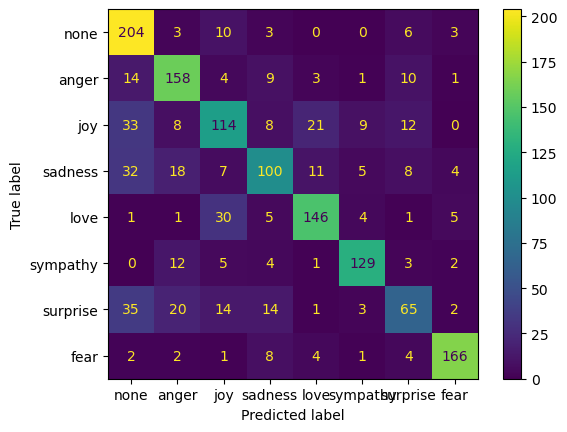

In [145]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Create a confusion matrix
cm = confusion_matrix(df_test['label'], y_pred, labels=log_reg.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_to_class)
disp.plot()
plt.show()

## LIME

In [31]:
def model_predict(text):
  tokens = bert_tokenize(text)
  xlen = np.array(tokens['input_ids']).shape[0]
  x_emb = np.zeros((xlen,768))
  for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = tokens['input_ids'][i:i+100]
        attention_mask = tokens['attention_mask'][i:i+100]
        token_type_ids = tokens['token_type_ids'][i:i+100]
        x_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = tokens['input_ids'][i:xlen]
        attention_mask = tokens['attention_mask'][i:xlen]
        token_type_ids = tokens['token_type_ids'][i:xlen]
        x_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)
  return log_reg.predict_proba(x_emb)

## SHAP

In [32]:
def shap_model_predict(text):
  text = text.astype(str).tolist()
  tokens = bert_tokenize(text)
  xlen = np.array(tokens['input_ids']).shape[0]
  x_emb = np.zeros((xlen,768))
  for i in range(0,xlen,100):
    if(i+100 < xlen):
        input_ids = tokens['input_ids'][i:i+100]
        attention_mask = tokens['attention_mask'][i:i+100]
        token_type_ids = tokens['token_type_ids'][i:i+100]
        x_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
        input_ids = tokens['input_ids'][i:xlen]
        attention_mask = tokens['attention_mask'][i:xlen]
        token_type_ids = tokens['token_type_ids'][i:xlen]
        x_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)
  return log_reg.predict_proba(x_emb)

In [33]:
'''
function that initializes shap with the appropriate model
parameters
model: an instance of your model, ex: LogisticRegression instance
'''
def initializeShap(model):
  # split input text into tokens
  masker = shap.maskers.Text(tokenizer=r"\W+")
  if isinstance(model, LogisticRegression):
    explainer = shap.Explainer(shap_model_predict, masker=masker, output_names=label_to_class)
  elif isinstance(model, MultinomialNB):
    explainer = shap.Explainer(shap_model_predict, masker=masker, output_names=label_to_class)
  else: print("Please use a valid model !")
  return explainer

In [34]:
log_reg_explainer = initializeShap(model=log_reg)

In [35]:
def map_label_to_class(indices, classes):
  return [classes[idx] for idx in indices]

In [36]:
def create_csv(y_pred_idx, y_true_idx, file_path="examples.csv"):
  y_pred, y_true = map_label_to_class(y_pred_idx, label_to_class), map_label_to_class(y_true_idx, label_to_class)
  with open(file_path, 'w') as file:
    file.write('Index,True Label,Predicted Label\n')
    for i in range(len(y_pred)):
      file.write(f'{i},{y_true[i]},{y_pred[i]}\n')
  print("Content has been written to the file.")

In [37]:
create_csv(y_pred, df_test['label'], file_path="examples.csv")

Content has been written to the file.


## Exploration

In [78]:
'''
label_to_class_dic = {
    0:'none',
    1:'anger',
    2:'joy',
    3:'sadness',
    4:'love',
    5:'sympathy',
    6:'surprise',
    7:'fear'
}
'''

"\nlabel_to_class_dic = {\n    0:'none',\n    1:'anger',\n    2:'joy',\n    3:'sadness',\n    4:'love',\n    5:'sympathy',\n    6:'surprise',\n    7:'fear'\n}\n"

In [88]:
def getconfused(true_label, pred_label):
    tp = df_test['label'] != y_pred
    tp = (((df_test['label'] == true_label) * (y_pred == pred_label))*tp)
    return tp[tp == True]

In [42]:
y_true = df_test['label']
# get correctly and incorrectly classified examples
correctly_classified, incorrectly_classified = [], []
for i in range(len(y_true)):
  if y_pred[i] == y_true[i]:  correctly_classified.append(i)
  else: incorrectly_classified.append(i)

In [43]:
i = incorrectly_classified[18]
instance = df_test[stemtype].iloc[i]
print("True label: ", label_to_class[df_test['label'].iloc[i]])
print("Predicted label: ", label_to_class[y_pred[i]])
print("Original tweet: ", df_test['tweet'].iloc[i])
# creating a LimeTextExplainer
explainer = LimeTextExplainer(class_names=label_to_class)

# explaining the prediction
explanation = explainer.explain_instance(instance, model_predict, num_features=10, labels = (y_pred[i],))

# showing the explanation
explanation.show_in_notebook()

True label:  anger
Predicted label:  sadness
Original tweet:  ارموهم في اعماق البحار حتي تشتت الامواج اشلائهم ..


In [44]:
instance = df_test[stemtype].iloc[i:i+1].values.astype(str).tolist()
print("True label: ", label_to_class[df_test['label'].iloc[i]])
print("Original tweet: ", df_test['tweet'].iloc[i])
shap_values = log_reg_explainer(instance)
shap.text_plot(shap_values)

True label:  anger
Original tweet:  ارموهم في اعماق البحار حتي تشتت الامواج اشلائهم ..


# loop through all incorrectly classifies examples and exctract the most common words that led to the wrong classfication

In [45]:
from nltk.tokenize import word_tokenize
word_tokenize("الرمزنة هي خطوة مهمة في معالجة اللغة الطبيعية.")

['الرمزنة', 'هي', 'خطوة', 'مهمة', 'في', 'معالجة', 'اللغة', 'الطبيعية', '.']

In [46]:
def get_word_frequency(df):
  # creating a dictionary to hold the number of times a specific word occurs
  word_frequency = {}
  for idx in incorrectly_classified:
    # tokenizing the words
    words_to_add = word_tokenize(df.iloc[idx])
    # looping through each word in list
    for word in words_to_add:
      if word in word_frequency:
        word_frequency[word] += 1
      else: word_frequency[word] = 1
  # soring the dictionary from most common words to least common
  sorted_list = sorted(word_frequency.items(), key=lambda word: word[1], reverse=True)
  return sorted_list

In [47]:
word_freq = get_word_frequency(df_test[stemtype])

In [48]:
# getting 10 most common words
print(word_freq[:10])

[('الاوليمبياد', 154), ('سخريه', 45), ('اللي', 42), ('مش', 39), ('مصر', 35), ('حب', 33), ('الله', 29), ('لا', 26), ('فرح', 21), ('حاجه', 18)]


# as we can see above are the most common words that lead to missclassification, lets try to understand why?

In [49]:
# see how the words above influence the classes
def word_occurance(word, df, y_pred):
  label_dic = {0:0, 1:0, 2:0, 3:0, 4:0, 5:0, 6:0, 7:0}
  for idx in incorrectly_classified:
    if word in df.iloc[idx]:
      label_dic[y_pred[idx]] += 1
  # create a new dictionary using label_to_class as keys
  new_dict = {label: label_dic.get(index, 0) for index, label in enumerate(label_to_class)}
  return new_dict

In [50]:
problamatic_words = [word[0] for word in word_freq[:10]]
print(problamatic_words)

['الاوليمبياد', 'سخريه', 'اللي', 'مش', 'مصر', 'حب', 'الله', 'لا', 'فرح', 'حاجه']


In [51]:
for word in problamatic_words:
  dic = word_occurance(word, df_test[stemtype], y_pred)
  print(f"Classes for Word {word}:\n{dic}", end="\n\n")

Classes for Word الاوليمبياد:
{'none': 115, 'anger': 2, 'joy': 14, 'sadness': 8, 'love': 0, 'sympathy': 0, 'surprise': 9, 'fear': 3}

Classes for Word سخريه:
{'none': 14, 'anger': 1, 'joy': 1, 'sadness': 3, 'love': 0, 'sympathy': 0, 'surprise': 0, 'fear': 0}

Classes for Word اللي:
{'none': 21, 'anger': 2, 'joy': 5, 'sadness': 3, 'love': 3, 'sympathy': 1, 'surprise': 4, 'fear': 2}

Classes for Word مش:
{'none': 24, 'anger': 7, 'joy': 8, 'sadness': 4, 'love': 1, 'sympathy': 3, 'surprise': 10, 'fear': 2}

Classes for Word مصر:
{'none': 34, 'anger': 2, 'joy': 6, 'sadness': 3, 'love': 0, 'sympathy': 0, 'surprise': 4, 'fear': 0}

Classes for Word حب:
{'none': 4, 'anger': 2, 'joy': 19, 'sadness': 6, 'love': 21, 'sympathy': 1, 'surprise': 6, 'fear': 4}

Classes for Word الله:
{'none': 8, 'anger': 6, 'joy': 12, 'sadness': 4, 'love': 4, 'sympathy': 9, 'surprise': 1, 'fear': 1}

Classes for Word لا:
{'none': 116, 'anger': 40, 'joy': 35, 'sadness': 23, 'love': 17, 'sympathy': 16, 'surprise': 20, 

# Misunderstanding of context

In [52]:
def explain_example_shap(i, class_to_explain):
  instance = df_test[stemtype].iloc[i:i+1].values.astype(str).tolist()
  print(df_test["tweet"].iloc[i])
  shap_values = log_reg_explainer(instance)
  # shap.text_plot(shap_values)
  # waterfall plot
  shap.text_plot(shap_values[0][:, class_to_explain])

In [53]:
def explain_example(idx):
  print("index:", idx)
  print(f"True Label {label_to_class_dic[y_true[idx]]} - Predicted Label {label_to_class_dic[y_pred[idx]]}")
  print(f"Explaining according to label {label_to_class_dic[y_pred[idx]]}")
  explain_example_shap(idx, y_pred[idx])
  # explaining the prediction
  explanation = explainer.explain_instance(df_test[stemtype].iloc[idx], model_predict, num_features=10, labels = (y_pred[idx],))

  # showing the explanation
  explanation.show_in_notebook()

In [54]:
explain_example(10)

index: 10
True Label fear - Predicted Label fear
Explaining according to label fear
يـوجعنـي قـلـبي،لمـا اتمـسك بانسان وانـا خايـفه يتـركنـي،تـوجعنـي فكـره ان النـاس كلهـم مـؤقتـين ومجـرد عـابريـن.💔


here it's labeled as fear and predicted as sadness however both labels here make sense and it's hard to pick one

In [55]:
explain_example(12)

index: 12
True Label sadness - Predicted Label surprise
Explaining according to label surprise
المصريين داخلين الاوليمبياد تمثيل مشرف


Here the sentence in confusing and i can't assign a label

In [56]:
explain_example(14)

index: 14
True Label sadness - Predicted Label anger
Explaining according to label anger
Mortada حرااااااام الظلم التحكيمي الفاجر ده


This example, i would label it as anger myself but it is labeled sadness

In [57]:
explain_example(21)

index: 21
True Label sadness - Predicted Label none
Explaining according to label none
يا جماعه الترينينج الاحمر بتاع مصر في الاوليمبياد ده بشع، اول مره كنت اشوفه وساره لابساه من شويه عشان ماتفرجتش علي الافتتاح..ايه البشاعه دي؟


  0%|          | 0/306 [00:00<?, ?it/s]

This example, I wouldn't label exactly as sadness or none, i would label at as disgust(??).

In [58]:
explain_example(62)

index: 62
True Label joy - Predicted Label none
Explaining according to label none
حسناً من الواضح اننا سنتابع الاوليمبياد . 🤔😄


This example a specific word decided the label

In [59]:
explain_example(69)

index: 69
True Label fear - Predicted Label love
Explaining according to label love
من كثر ما احبه ودي اروح اخطبه من ابوه بس خايفه يرفض 😬😬


This case is one of mixed feelings so the mistake is understandable

In [60]:
explain_example(74)

index: 74
True Label none - Predicted Label none
Explaining according to label none
دول افريفيا مبوزه سمعتنا في الاوليمبياد


In this case i would say that the prediction is more correct

In [61]:
explain_example(77)

index: 77
True Label sadness - Predicted Label none
Explaining according to label none
محدش عارف هما تعبوا اد ايه عشان يوصلوا الاوليمبياد و هم مش ناقصين تعليقات الجهله في اللعبه لادائهم و لا تعليقات المصريين عموما علي لبسهم


  0%|          | 0/272 [00:00<?, ?it/s]

One word has too much weight

In [62]:
explain_example(79)

index: 79
True Label love - Predicted Label sympathy
Explaining according to label sympathy
ساعه استجابه   الرامي عبدالله الطرقي الرشيدي  الله يوفقكك وينصركك يابو طلال   تكفون دعواتكمم ????????


The model misunderstood the context here.

# Samples across all models

None

In [63]:
explain_example(3)

index: 3
True Label none - Predicted Label none
Explaining according to label none
نفسي اشوف قطري جد جد مشارك في الاوليمبياد نفس الشئ ينطبق علي الفرنسيين


In [64]:
explain_example(2)

index: 2
True Label joy - Predicted Label none
Explaining according to label none
الاوليمبياد السنه دي افشخ من سيدني اللي كنا بنزوغ من المدرسه علشان نتفرج عليها 😀


Anger

In [65]:
explain_example(1)

index: 13
True Label anger - Predicted Label anger
Explaining according to label anger
السعوديه الثالثه في السمنه مفروض الاولي ب السمنه علي كثر ما يسوون تكميم ????????


In [66]:
explain_example(429)

index: 429
True Label sadness - Predicted Label anger
Explaining according to label anger
جنود بريطانيون يرمون اوسمتهم امام مبني الحكومه لا يمكننا ان نجني السلام ونحن نقتل مدنيين بحجه  داعش وعلي  بريطانيا بالانسحاب من التحالف الدولي


  0%|          | 0/342 [00:00<?, ?it/s]

Joy

In [67]:
explain_example(43)

index: 65
True Label joy - Predicted Label joy
Explaining according to label joy
88  هههههههههههه لا تلومني توي صاحي من فرحه غيبوبه الدوري  ????


In [68]:
explain_example(354)

index: 203
True Label love - Predicted Label joy
Explaining according to label joy
احلام العنزي فخر الكويت الف الف مبروووووك بنت قبيلتي وبنت ديرتييييي???????????????????? كفو عيال الديره كل يوم اسم رافع اسمنا بشاره خير ان شاء الله


  0%|          | 0/462 [00:00<?, ?it/s]

Partition explainer: 2it [00:13, 13.10s/it]               


Sadness

In [69]:
explain_example(56)

index: 27
True Label sadness - Predicted Label fear
Explaining according to label fear
عيش لوحدك حتي لو هتموت احسن من انك تفرض نفسك علي حد مش عيزك


In [70]:
explain_example(391)

index: 60
True Label anger - Predicted Label sadness
Explaining according to label sadness
ارموهم في اعماق البحار حتي تشتت الامواج اشلائهم ..


Love

In [71]:
explain_example(44)

index: 9
True Label love - Predicted Label love
Explaining according to label love
: اللهم ارزقنا ك و من  يحبك وسعاده في الدنيا ورضا في الاخره ، اللهم لنا احبه وقلوبا محبه نريدها ان تجتمع فجمعها علي بركه…


  0%|          | 0/210 [00:00<?, ?it/s]

In [72]:
explain_example(263)

index: 263
True Label joy - Predicted Label love
Explaining according to label love
لا يوووووووصف ????❤  احساس خالد عبدالرحمن


Sympathy

In [73]:
explain_example(32)

index: 32
True Label sympathy - Predicted Label sympathy
Explaining according to label sympathy
o:  تراجف ايديني من البرد وقول الله يكون بعون اخوننا ب  العراق و و  اليمن اللهم ان الكل خذلهم فانصرهم يارب 💔🙏🏻


  0%|          | 0/306 [00:00<?, ?it/s]

In [74]:
explain_example(172)

index: 172
True Label love - Predicted Label sympathy
Explaining according to label sympathy
: خطاكم السوء .. يا اهل الامارات الغاليه  الله يحفظكم .. من كل مكروه ..


Surprise

In [75]:
explain_example(17)

index: 17
True Label surprise - Predicted Label surprise
Explaining according to label surprise
مش معقووول .. اهنيك علي هذي الموهبه .. ابداع يفوق الوصف


Fear

In [76]:
explain_example(1496)

index: 4
True Label fear - Predicted Label fear
Explaining according to label fear
she3er: سمعت ان الحنين يقصرّ الاعمار ! انا خايف تغيب اكثر و   احتضرك


In [77]:
explain_example(22)

index: 768
True Label love - Predicted Label fear
Explaining according to label fear
لا تغيب اكثر حـبـيـبـي خاف اموت من الـحـنـيـن  Love


# Examining the Confusion Matrix

In [110]:
con = getconfused(6,0).index.values
for i in con:
    print("index:", i)
    print(f"True Label {label_to_class_dic[y_true[i]]} - Predicted Label {label_to_class_dic[y_pred[i]]}")
    print('Original: ',df_test['tweet'].iloc[i])
    print('Cleaned: ',df_test[stemtype].iloc[i])
    print('------------------------------------------------------------------------------------------------------------------------')

index: 34
True Label surprise - Predicted Label none
Original:  اوليمبياد ريو غريب وعجيب لا احد يسال لماذا غابت الفروسيه السعوديه وهي ثروتنا وعزنا ومجدنا عن الاوليمبياد ومن المسؤول
Cleaned:  اوليمبياد ريو غريب وعجيب لا احد يسال لماذا غابت الفروسيه السعوديه ثروتنا وعزنا ومجدنا الاوليمبياد المسؤول
------------------------------------------------------------------------------------------------------------------------
index: 109
True Label surprise - Predicted Label none
Original:  هي الستات اللي بيجيلها بيريود ف الاوليمبياد بيشاركوا برضو ؟؟ ....الالعاب الاوليمبيه
Cleaned:  الستات اللي بيجيلها بيريود الاوليمبياد بيشاركوا برضو الالعاب الاوليمبيه
------------------------------------------------------------------------------------------------------------------------
index: 154
True Label surprise - Predicted Label none
Original:  نهله رمضان لم تحصل علي ميداليه اوليمبيه .. لبخت في الاوليمبياد وكانت صدمه
Cleaned:  نهله رمضان لم تحصل ميداليه اوليمبيه لبخت الاوليمبياد وكانت صدمه
-----------------

In [115]:
explain_example(1324)

index: 1324
True Label surprise - Predicted Label none
Explaining according to label none
عارفين قطر اللي كنا بنتتريق علي عدد سكانها ؟ ومساحتها ؟ شوفوها بتعمل ايه في الاوليمبياد باه واحنا ال90 مليون نسمه ومليون كيلو متر بنعمل ايه


  0%|          | 0/380 [00:00<?, ?it/s]

Partition explainer: 2it [00:10, 10.51s/it]               
